# Bicubic Interpolation

**Bicubic interpolation** is a standard and simple method for upscaling images, and it provides a solid baseline for comparison. The smooth but blurry nature of bicubic interpolation is a well-known characteristic, making it a good reference point to demonstrate the improvements brought by more advanced super-resolution techniques.

In [44]:
import os
import glob
import torch
import random
import numpy as np
import pandas as pd
import torch.nn as nn
from PIL import Image
from tqdm.auto import tqdm
from torchvision.transforms import v2
from torchmetrics.image import PeakSignalNoiseRatio
from torchmetrics.image import StructuralSimilarityIndexMeasure
from torchmetrics.image.lpip import LearnedPerceptualImagePatchSimilarity

In [2]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

## Model and data preparation

In [3]:
HR_valid_paths = sorted(glob.glob("./data/DIV2K_valid_HR/*.png"))
X2_valid_paths = sorted(glob.glob("./data/DIV2K_valid_LR_bicubic/X2/*.png"))
X4_valid_paths = sorted(glob.glob("./data/DIV2K_valid_LR_bicubic/X4/*.png"))
X8_valid_paths = sorted(glob.glob("./data/DIV2K_valid_LR_bicubic/X8/*.png"))
X16_valid_paths = sorted(glob.glob("./data/DIV2K_valid_LR_bicubic/X16/*.png"))
X32_valid_paths = sorted(glob.glob("./data/DIV2K_valid_LR_bicubic/X32/*.png"))
X64_valid_paths = sorted(glob.glob("./data/DIV2K_valid_LR_bicubic/X64/*.png"))

Throughout all my experiments I am going to use 3 metrics
1) Peak Signal-to-Noise Ratio (**PSNR**)
   - It measures pixel-wise similarity based on Mean Squared Error (**MSE**)
   - Higher is better
   - **Limitations**:
        - Highly sensitive to small pixel changes but doesn’t align well with human perception
        - Does not consider structural or perceptual quality
        - Penalizes sharp images, even if they look better
2) Structural Similarity Index Measure (**SSIM**)
   - It compares luminance, contrast, and structure between the original and super-resolved images
   - Between 0 and 1 (higher is better, 1 = perfect match)
   - **Limitations**:
        - Sensitive to brightness and contrast differences
        - Less effective for evaluating texture details
3) Learned Perceptual Image Patch Similarity (**LPIPS**)
    - It measures perceptual similarity based on deep features extracted from a pretrained neural network (e.g., VGG)
    - Lower is better (0 means perfect perceptual match)
    - **Limitations**:
        - More computationally expensive than PSNR/SSIM
        - May not always reflect small pixel-wise changes

These 3 metrics suplement each other providing a robust evaluation, LPIPS is computationally expensive therefore I will use it less frequently than PSNR and SSIM, perhaps once per few iterations or just at the end of training

In [4]:
psnr = PeakSignalNoiseRatio()
ssim = StructuralSimilarityIndexMeasure(data_range=2.0)
lpips = LearnedPerceptualImagePatchSimilarity().to(device)

In [5]:
transform = v2.Compose([
    v2.PILToTensor(),
    v2.Lambda(lambda x: 2.0*x/255.0 - 1.0)
])

In [6]:
class BicubicInterpolation:
    def __init__(self, goal_img_path: str):
        image = Image.open(goal_img_path)
        self.goal_width = image.width
        self.goal_height = image.height

    def forward(self, img_path: str):
        image = Image.open(img_path)
        scaled_image = image.resize((self.goal_width, self.goal_height), Image.Resampling.BICUBIC)
        return transform(scaled_image)

In [7]:
def calc_metrics(input_ds: list[str], target_ds: list[str]):
    psnr_acc = 0
    ssim_acc = 0
    lpips_acc = 0
    failed_lpips = 0
    for i in tqdm(range(len(input_ds)), leave=False):
        bi = BicubicInterpolation(target_ds[i])
        input_image = bi.forward(input_ds[i])[None]
        target_image = transform(Image.open(target_ds[i]))[None]
        
        psnr_acc += psnr(input_image, target_image).item()
        ssim_acc += ssim(input_image, target_image).item()
        
        # There are 2 images that cause lpips to fail
        try:
            x = lpips(input_image.to(device), target_image.to(device)).cpu().item()
            if np.isnan(x):
                failed_lpips += 1
                continue
                
            lpips_acc += x
        except:
            failed_lpips += 1

    lpips_acc /= len(input_ds) - failed_lpips
    psnr_acc /= len(input_ds)
    ssim_acc /= len(input_ds)
    return psnr_acc, ssim_acc, lpips_acc

## X2 Scaling

### Metrics calculation

In [8]:
inputs = [X64_valid_paths, X32_valid_paths, X16_valid_paths, X8_valid_paths, X4_valid_paths, X2_valid_paths]
targets = [X32_valid_paths, X16_valid_paths, X8_valid_paths, X4_valid_paths, X2_valid_paths, HR_valid_paths]

In [9]:
metrics_x2 = pd.DataFrame(columns=["PSNR", "SSIM", "LPIPS"])
for input_ds, target_ds in tqdm(zip(inputs, targets), total=6):
    metrics_x2.loc[len(metrics_x2)] = calc_metrics(input_ds, target_ds)

# Create a custom index based on input and target resolutions
metrics_x2.index = [
    "31px -> 63px", "63px -> 127px", "127px -> 255px", 
    "255px -> 510px", "510px -> 1020px", "1020px -> 2040px"
]
metrics_x2

  0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

,PSNR,SSIM,LPIPS
31px -> 63px,23.597464,0.790835,0.168235
63px -> 127px,24.955435,0.818133,0.215052
127px -> 255px,26.445934,0.846890,0.211631
255px -> 510px,27.700864,0.863648,0.201476
510px -> 1020px,29.593097,0.887721,0.173096
1020px -> 2040px,30.987346,0.890565,0.183161


### Super-resolution showcase

31px -> 63px


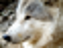

In [20]:
print("31px -> 63px")
bi = BicubicInterpolation(X32_valid_paths[4])
out = (bi.forward(X64_valid_paths[4]) + 1.0) / 2.0 * 255.0
Image.fromarray(out.permute(1, 2, 0).to(torch.uint8).numpy())

63px -> 127px


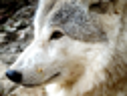

In [21]:
print("63px -> 127px")
bi = BicubicInterpolation(X16_valid_paths[4])
out = (bi.forward(X32_valid_paths[4]) + 1.0) / 2.0 * 255.0
Image.fromarray(out.permute(1, 2, 0).to(torch.uint8).numpy())

127px -> 255px


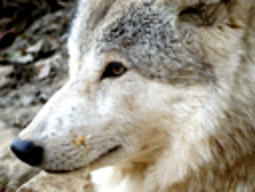

In [22]:
print("127px -> 255px")
bi = BicubicInterpolation(X8_valid_paths[4])
out = (bi.forward(X16_valid_paths[4]) + 1.0) / 2.0 * 255.0
Image.fromarray(out.permute(1, 2, 0).to(torch.uint8).numpy())

255px -> 510px


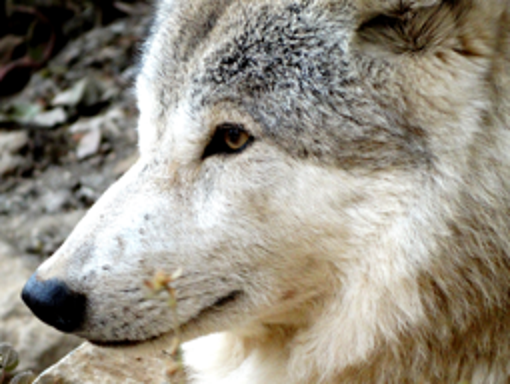

In [23]:
print("255px -> 510px")
bi = BicubicInterpolation(X4_valid_paths[4])
out = (bi.forward(X8_valid_paths[4]) + 1.0) / 2.0 * 255.0
Image.fromarray(out.permute(1, 2, 0).to(torch.uint8).numpy())

510px -> 1020px


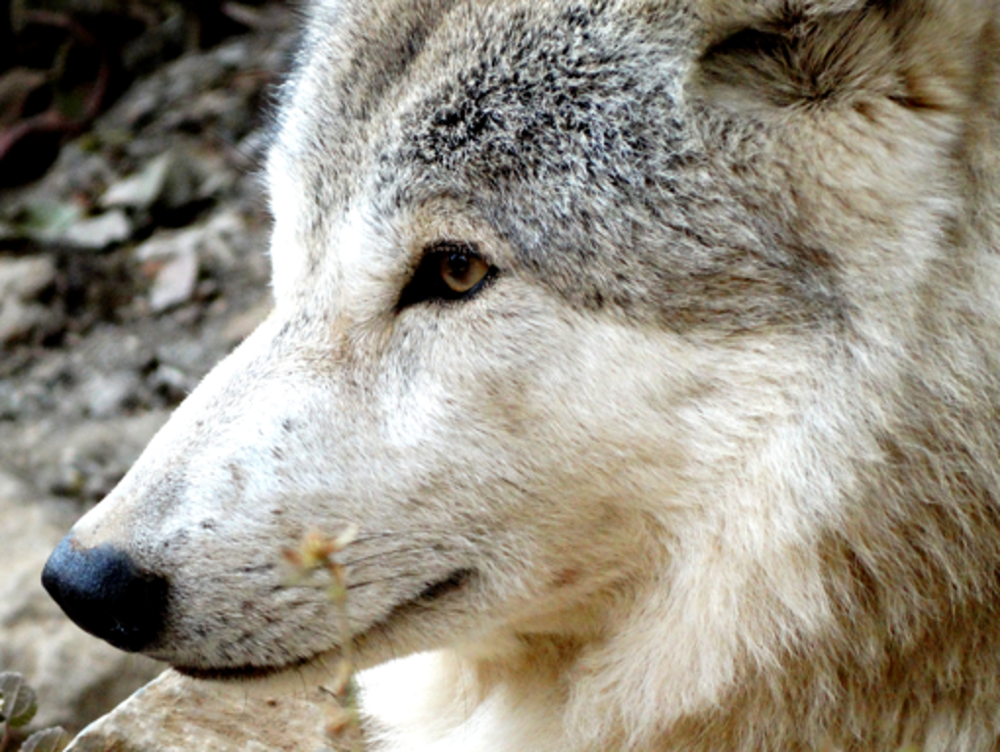

In [24]:
print("510px -> 1020px")
bi = BicubicInterpolation(X2_valid_paths[4])
out = (bi.forward(X4_valid_paths[4]) + 1.0) / 2.0 * 255.0
Image.fromarray(out.permute(1, 2, 0).to(torch.uint8).numpy())

1020px -> 2040px


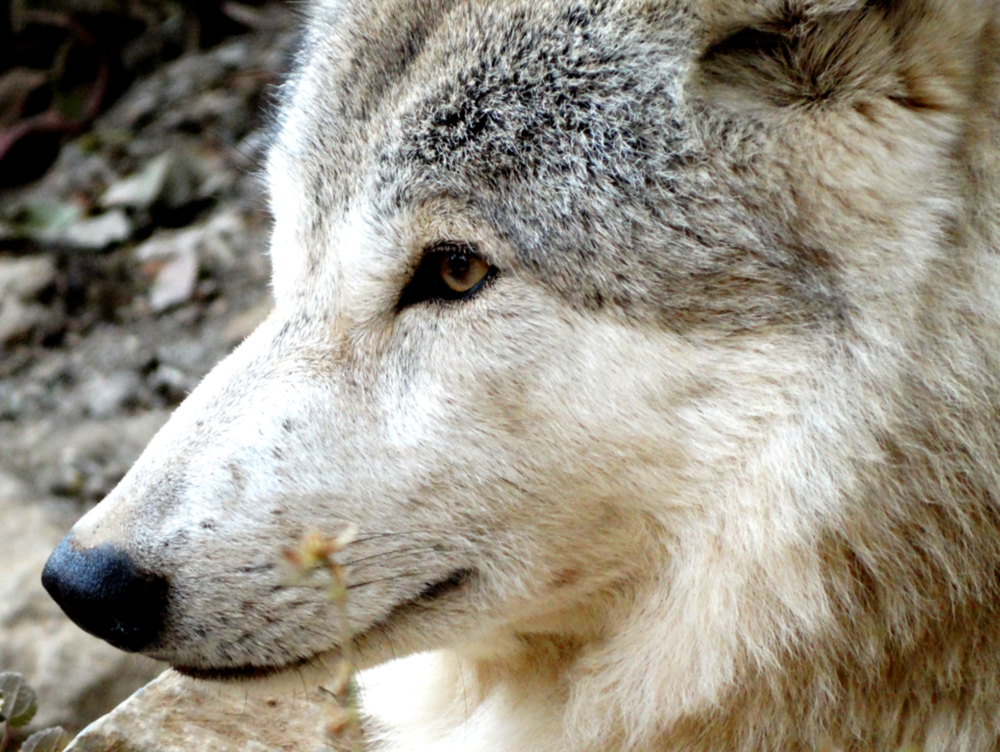

In [25]:
print("1020px -> 2040px")
bi = BicubicInterpolation(HR_valid_paths[4])
out = (bi.forward(X2_valid_paths[4]) + 1.0) / 2.0 * 255.0
Image.fromarray(out.permute(1, 2, 0).to(torch.uint8).numpy())

## X4 Scaling

### Metrics calculation

In [10]:
inputs = [X64_valid_paths, X32_valid_paths, X16_valid_paths, X8_valid_paths, X4_valid_paths]
targets = [X16_valid_paths, X8_valid_paths, X4_valid_paths, X2_valid_paths, HR_valid_paths]

In [11]:
metrics_x4 = pd.DataFrame(columns=["PSNR", "SSIM", "LPIPS"])
for input_ds, target_ds in tqdm(zip(inputs, targets), total=5):
    metrics_x4.loc[len(metrics_x4)] = calc_metrics(input_ds, target_ds)

# Create a custom index based on input and target resolutions
metrics_x4.index = ["31px -> 127px", "63px -> 255px", "127px -> 510px", "255px -> 1020px", "510px -> 2040px"]
metrics_x4

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

,PSNR,SSIM,LPIPS
31px -> 127px,20.879417,0.536578,0.519055
63px -> 255px,22.200187,0.597926,0.497202
127px -> 510px,23.460044,0.650415,0.463252
255px -> 1020px,25.020576,0.702028,0.421972
510px -> 2040px,26.645133,0.739792,0.408925


### Super-resolution showcase

31px -> 127px


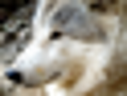

In [47]:
print("31px -> 127px")
bi = BicubicInterpolation(X16_valid_paths[4])
out = (bi.forward(X64_valid_paths[4]) + 1.0) / 2.0 * 255.0
Image.fromarray(out.permute(1, 2, 0).to(torch.uint8).numpy())

63px -> 255px


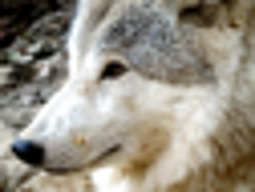

In [48]:
print("63px -> 255px")
bi = BicubicInterpolation(X8_valid_paths[4])
out = (bi.forward(X32_valid_paths[4]) + 1.0) / 2.0 * 255.0
Image.fromarray(out.permute(1, 2, 0).to(torch.uint8).numpy())

127px -> 510px


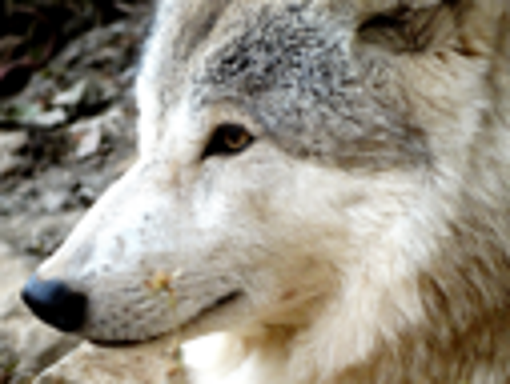

In [49]:
print("127px -> 510px")
bi = BicubicInterpolation(X4_valid_paths[4])
out = (bi.forward(X16_valid_paths[4]) + 1.0) / 2.0 * 255.0
Image.fromarray(out.permute(1, 2, 0).to(torch.uint8).numpy())

255px -> 1020px


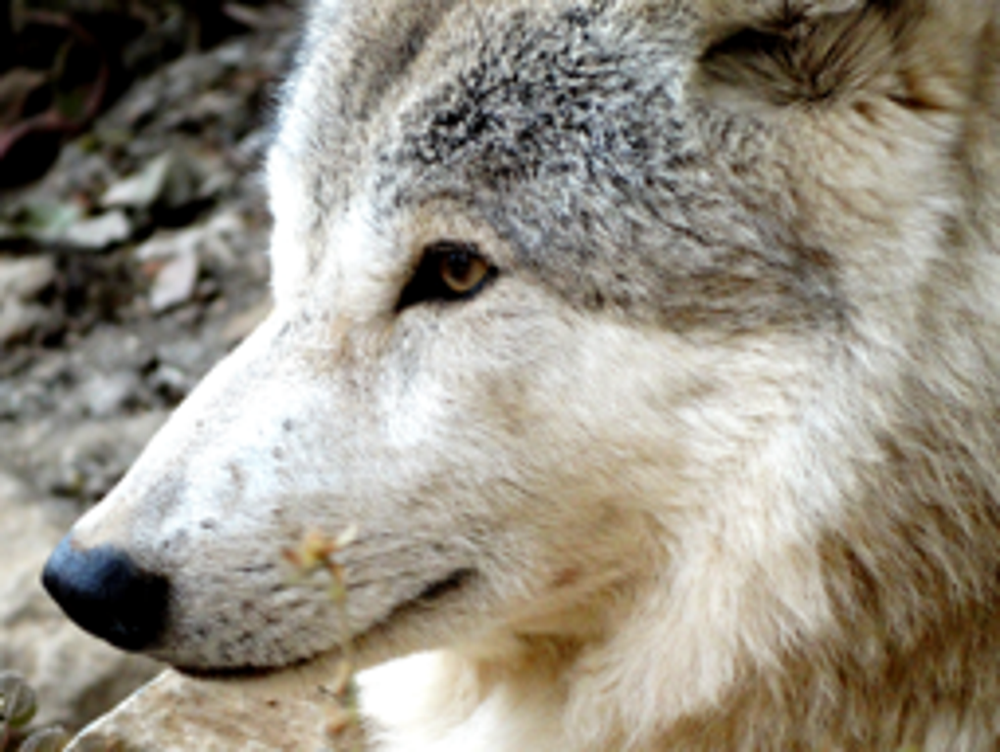

In [50]:
print("255px -> 1020px")
bi = BicubicInterpolation(X2_valid_paths[4])
out = (bi.forward(X8_valid_paths[4]) + 1.0) / 2.0 * 255.0
Image.fromarray(out.permute(1, 2, 0).to(torch.uint8).numpy())

510px -> 2040px


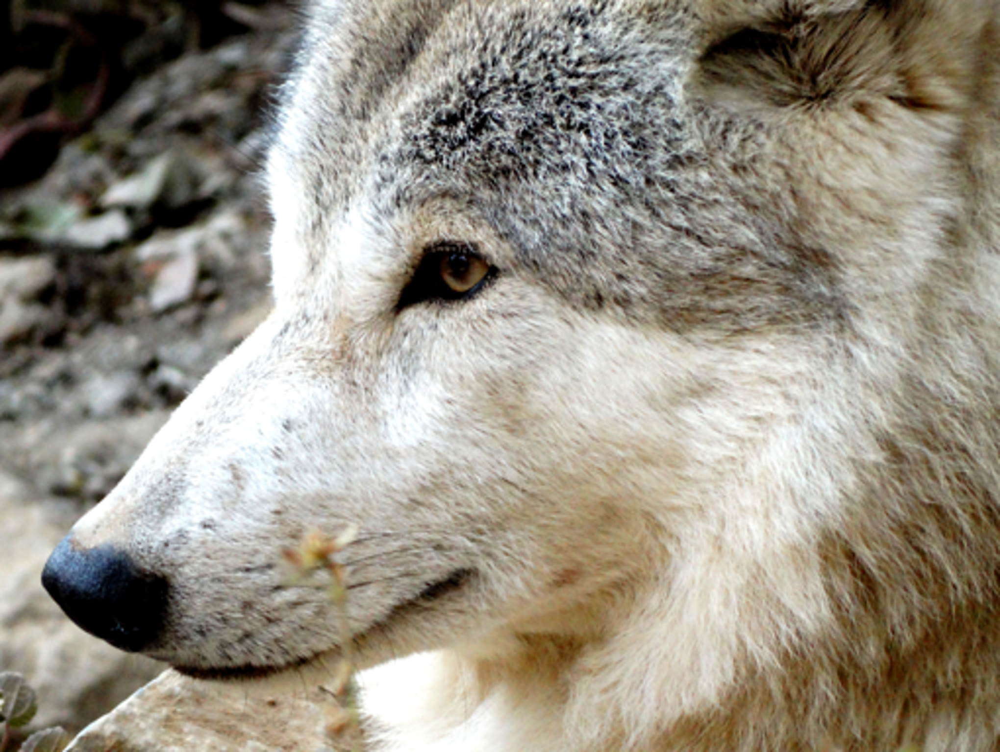

In [52]:
print("510px -> 2040px")
bi = BicubicInterpolation(HR_valid_paths[4])
out = (bi.forward(X4_valid_paths[4]) + 1.0) / 2.0 * 255.0
Image.fromarray(out.permute(1, 2, 0).to(torch.uint8).numpy())

## X8 Scaling

### Metrics calculation

In [12]:
inputs = [X64_valid_paths, X32_valid_paths, X16_valid_paths, X8_valid_paths]
targets = [X8_valid_paths, X4_valid_paths, X2_valid_paths, HR_valid_paths]

In [13]:
metrics_x8 = pd.DataFrame(columns=["PSNR", "SSIM", "LPIPS"])
for input_ds, target_ds in tqdm(zip(inputs, targets), total=4):
    metrics_x8.loc[len(metrics_x8)] = calc_metrics(input_ds, target_ds)

# Create a custom index based on input and target resolutions
metrics_x8.index = ["31px -> 255px", "63px -> 510px", "127px -> 1020px", "255px -> 2040px"]
metrics_x8

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

,PSNR,SSIM,LPIPS
31px -> 255px,19.578372,0.411081,0.725214
63px -> 510px,20.768317,0.482136,0.682884
127px -> 1020px,22.165209,0.554016,0.627094
255px -> 2040px,23.648650,0.610018,0.590486


### Super-resolution showcase

31px -> 255px


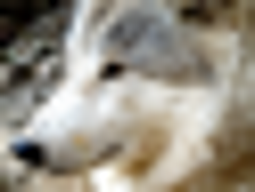

In [53]:
print("31px -> 255px")
bi = BicubicInterpolation(X8_valid_paths[4])
out = (bi.forward(X64_valid_paths[4]) + 1.0) / 2.0 * 255.0
Image.fromarray(out.permute(1, 2, 0).to(torch.uint8).numpy())

63px -> 510px


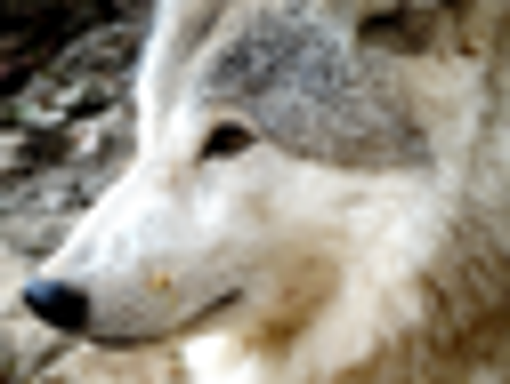

In [54]:
print("63px -> 510px")
bi = BicubicInterpolation(X4_valid_paths[4])
out = (bi.forward(X32_valid_paths[4]) + 1.0) / 2.0 * 255.0
Image.fromarray(out.permute(1, 2, 0).to(torch.uint8).numpy())

127px -> 1020px


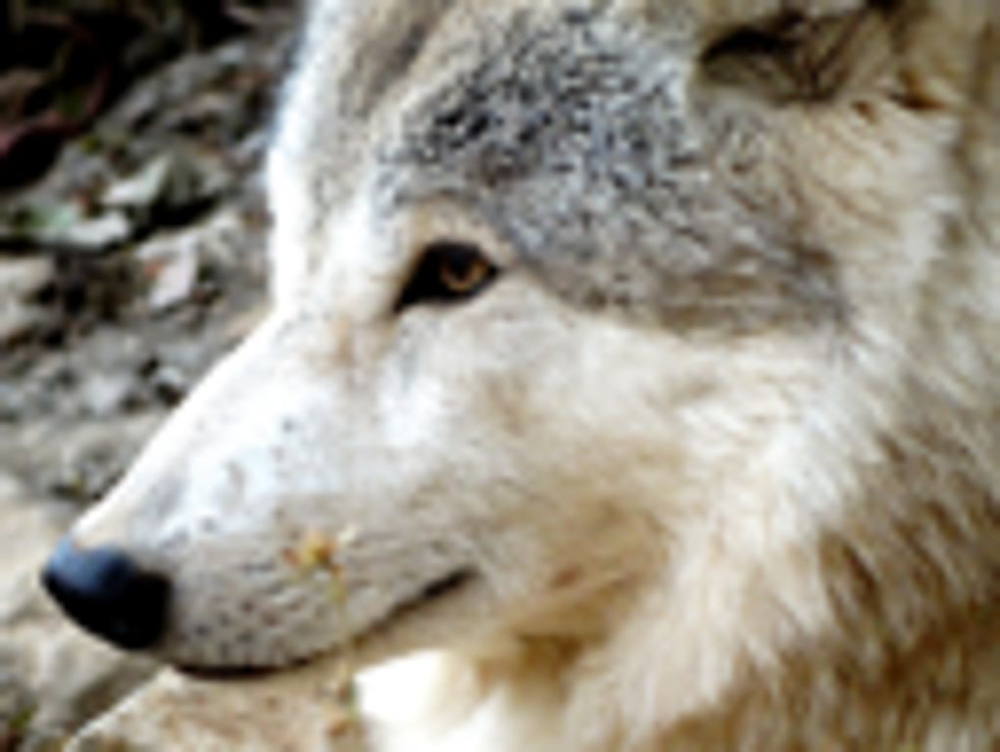

In [55]:
print("127px -> 1020px")
bi = BicubicInterpolation(X2_valid_paths[4])
out = (bi.forward(X16_valid_paths[4]) + 1.0) / 2.0 * 255.0
Image.fromarray(out.permute(1, 2, 0).to(torch.uint8).numpy())

255px -> 2040px


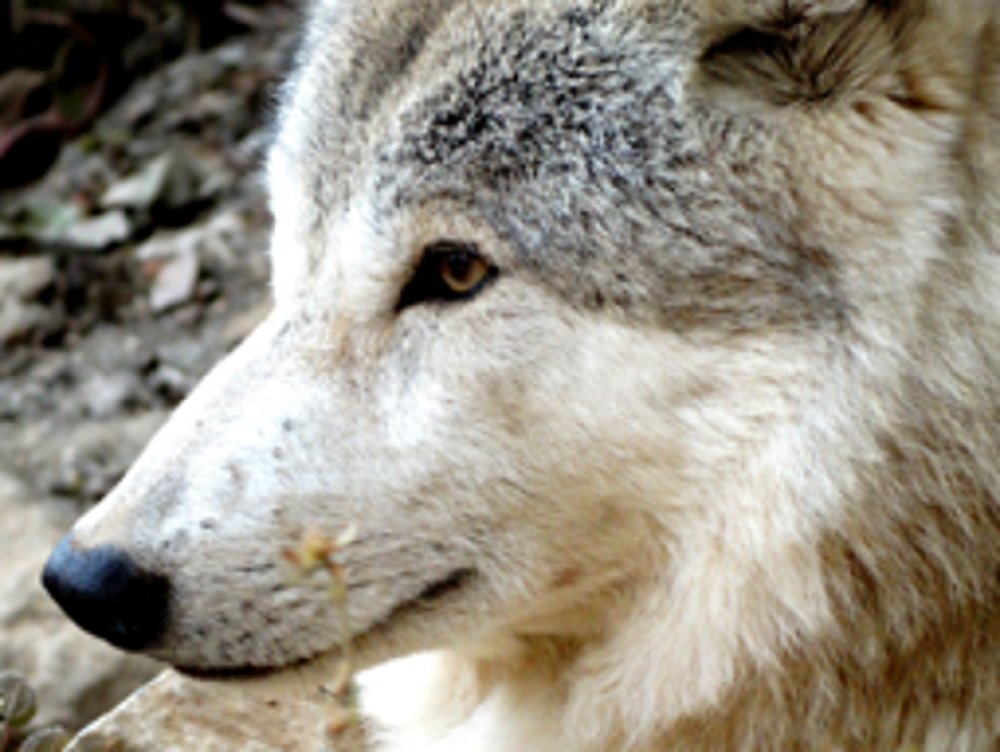

In [56]:
print("255px -> 2040px")
bi = BicubicInterpolation(HR_valid_paths[4])
out = (bi.forward(X8_valid_paths[4]) + 1.0) / 2.0 * 255.0
Image.fromarray(out.permute(1, 2, 0).to(torch.uint8).numpy())

## X16 Scaling

### Metrics calculation

In [14]:
inputs = [X64_valid_paths, X32_valid_paths, X16_valid_paths]
targets = [X4_valid_paths, X2_valid_paths, HR_valid_paths]

In [15]:
metrics_x16 = pd.DataFrame(columns=["PSNR", "SSIM", "LPIPS"])
for input_ds, target_ds in tqdm(zip(inputs, targets), total=3):
    metrics_x16.loc[len(metrics_x16)] = calc_metrics(input_ds, target_ds)

# Create a custom index based on input and target resolutions
metrics_x16.index = ["31px -> 510px", "63px -> 1020px", "127px -> 2040px"]
metrics_x16

  0%|          | 0/3 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

,PSNR,SSIM,LPIPS
31px -> 510px,18.731738,0.398998,0.797858
63px -> 1020px,20.000326,0.476369,0.747775
127px -> 2040px,21.372555,0.540542,0.712447


### Super-resolution showcase

31px -> 510px


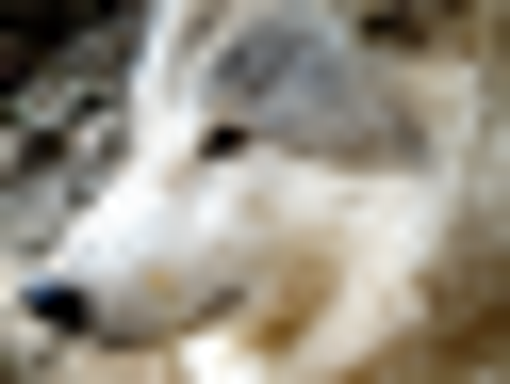

In [57]:
print("31px -> 510px")
bi = BicubicInterpolation(X4_valid_paths[4])
out = (bi.forward(X64_valid_paths[4]) + 1.0) / 2.0 * 255.0
Image.fromarray(out.permute(1, 2, 0).to(torch.uint8).numpy())

63px -> 510px


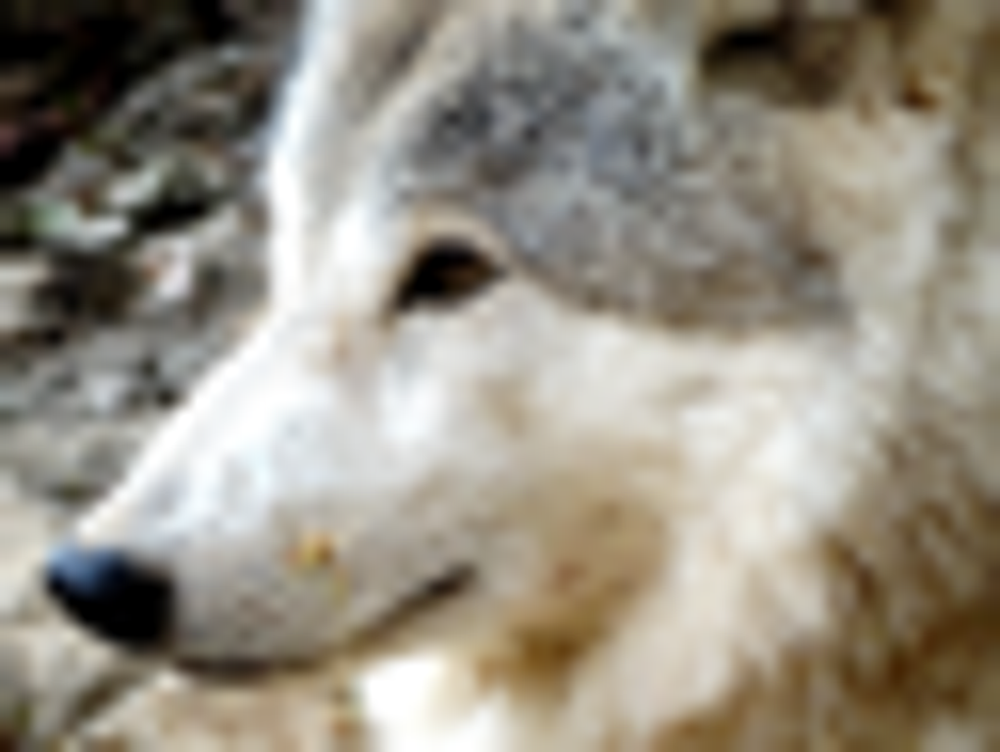

In [58]:
print("63px -> 1020px")
bi = BicubicInterpolation(X2_valid_paths[4])
out = (bi.forward(X32_valid_paths[4]) + 1.0) / 2.0 * 255.0
Image.fromarray(out.permute(1, 2, 0).to(torch.uint8).numpy())

127px -> 2040px


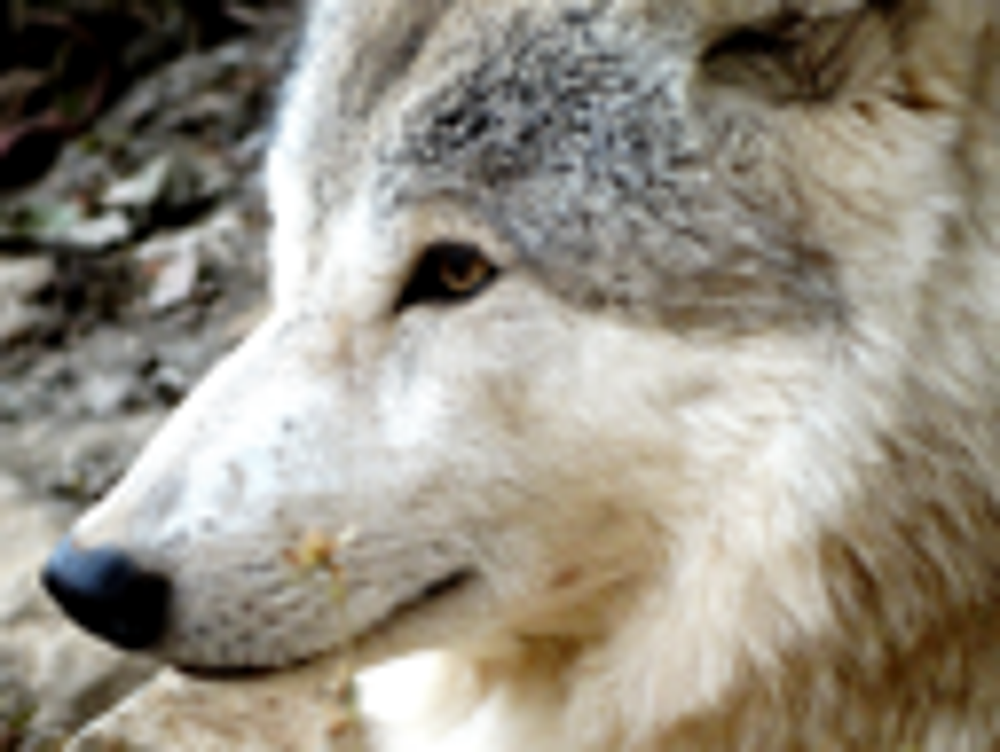

In [59]:
print("127px -> 2040px")
bi = BicubicInterpolation(HR_valid_paths[4])
out = (bi.forward(X16_valid_paths[4]) + 1.0) / 2.0 * 255.0
Image.fromarray(out.permute(1, 2, 0).to(torch.uint8).numpy())

## X32 Scaling

### Metrics calculation

In [16]:
inputs = [X64_valid_paths, X32_valid_paths]
targets = [X2_valid_paths, HR_valid_paths]

In [17]:
metrics_x32 = pd.DataFrame(columns=["PSNR", "SSIM", "LPIPS"])
for input_ds, target_ds in tqdm(zip(inputs, targets), total=2):
    metrics_x32.loc[len(metrics_x32)] = calc_metrics(input_ds, target_ds)

# Create a custom index based on input and target resolutions
metrics_x32.index = ["31px -> 1020px", "63px -> 2040px"]
metrics_x32

  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

,PSNR,SSIM,LPIPS
31px -> 1020px,18.222935,0.431023,0.804698
63px -> 2040px,19.489356,0.498466,0.769348


### Super-resolution showcase

31px -> 1020px


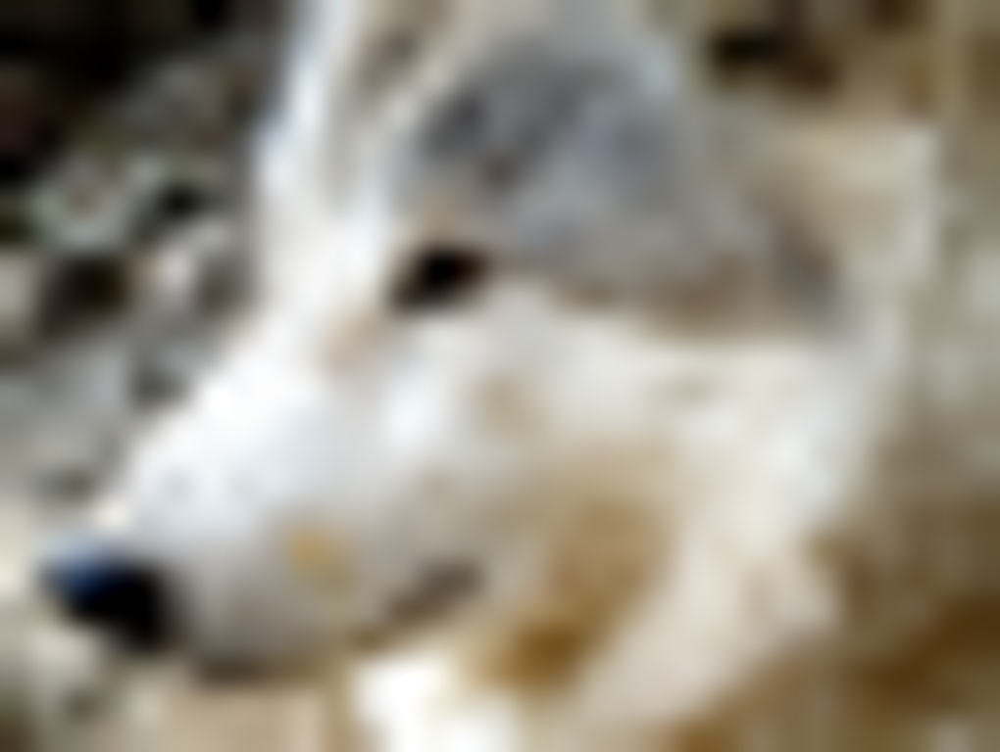

In [60]:
print("31px -> 1020px")
bi = BicubicInterpolation(X2_valid_paths[4])
out = (bi.forward(X64_valid_paths[4]) + 1.0) / 2.0 * 255.0
Image.fromarray(out.permute(1, 2, 0).to(torch.uint8).numpy())

63px -> 2040px


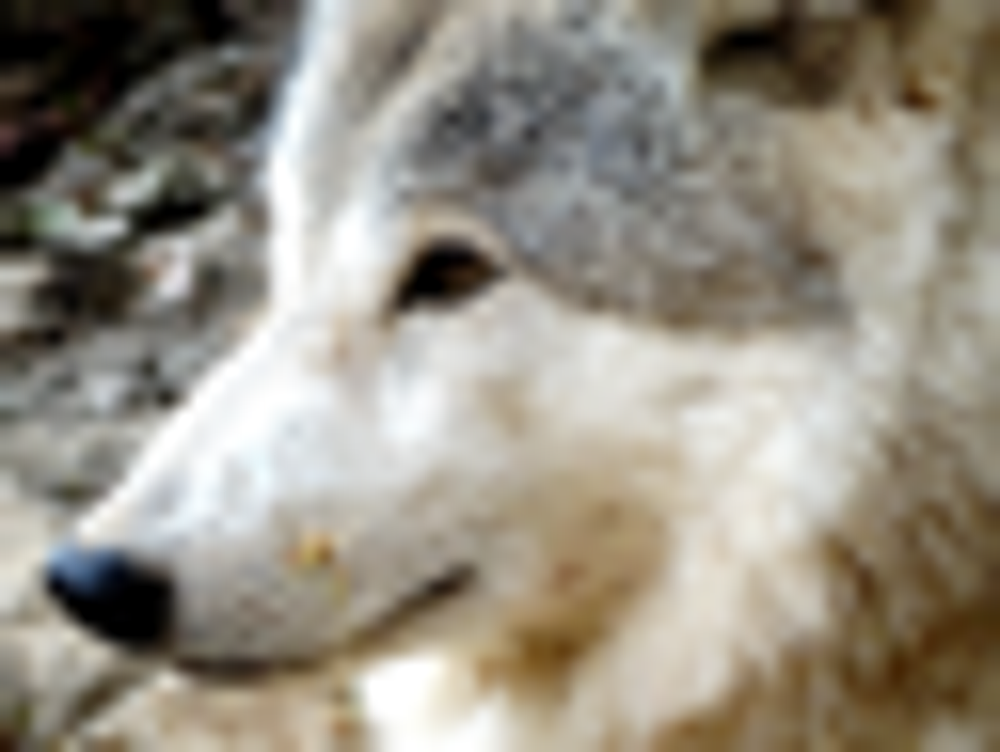

In [61]:
print("63px -> 2040px")
bi = BicubicInterpolation(HR_valid_paths[4])
out = (bi.forward(X32_valid_paths[4]) + 1.0) / 2.0 * 255.0
Image.fromarray(out.permute(1, 2, 0).to(torch.uint8).numpy())

## X64 Scaling

### Metrics calculation

In [19]:
metrics_x64 = pd.DataFrame(columns=["PSNR", "SSIM", "LPIPS"])
metrics_x64.loc[len(metrics_x64)] = calc_metrics(X64_valid_paths, HR_valid_paths)
metrics_x64.index = ["31px -> 2040px"]
metrics_x64

  0%|          | 0/100 [00:00<?, ?it/s]

,PSNR,SSIM,LPIPS
31px -> 2040px,17.874137,0.459533,0.797417


### Super-resolution showcase

31px -> 2040px


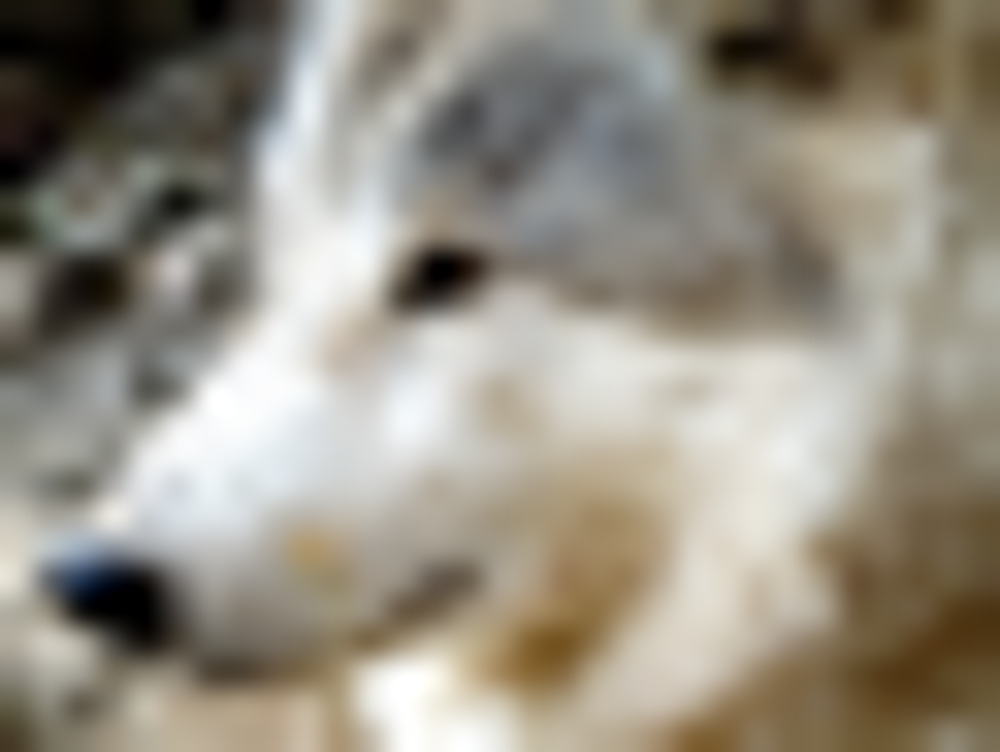

In [62]:
print("31px -> 2040px")
bi = BicubicInterpolation(HR_valid_paths[4])
out = (bi.forward(X64_valid_paths[4]) + 1.0) / 2.0 * 255.0
Image.fromarray(out.permute(1, 2, 0).to(torch.uint8).numpy())

## Final Results

In [34]:
index_x2 = pd.MultiIndex.from_product([["X2"], [
    "31px -> 63px", "63px -> 127px", "127px -> 255px", 
    "255px -> 510px", "510px -> 1020px", "1020px -> 2040px"
]], names=["Scaling", "Resolution"])

index_x4 = pd.MultiIndex.from_product([["X4"], [
    "31px -> 127px", "63px -> 255px", "127px -> 510px", 
    "255px -> 1020px", "510px -> 2040px"
]], names=["Scaling", "Resolution"])

index_x8 = pd.MultiIndex.from_product([["X8"], [
    "31px -> 255px", "63px -> 510px", "127px -> 1020px", "255px -> 2040px"]], names=["Scaling", "Resolution"])

index_x16 = pd.MultiIndex.from_product([["X16"], [
    "31px -> 510px", "63px -> 1020px", "127px -> 2040px"]], names=["Scaling", "Resolution"])

index_x32 = pd.MultiIndex.from_product([["X32"], ["31px -> 1020px", "63px -> 2040px"]], names=["Scaling", "Resolution"])

index_x64 = pd.MultiIndex.from_product([["X64"], ["31px -> 2040px"]], names=["Scaling", "Resolution"])

metrics_x2.index = index_x2
metrics_x4.index = index_x4
metrics_x8.index = index_x8
metrics_x16.index = index_x16
metrics_x32.index = index_x32
metrics_x64.index = index_x64
empty_row = pd.DataFrame([[np.nan, np.nan, np.nan]], columns=["PSNR", "SSIM", "LPIPS"], 
                         index = pd.MultiIndex.from_tuples([("--", "--")], names=["Scaling", "Resolution"]))
metrics_full = pd.concat([metrics_x2, empty_row, metrics_x4, empty_row, metrics_x8, empty_row, metrics_x16, 
                          empty_row, metrics_x32, empty_row, metrics_x64])
metrics_full

PSNR      SSIM     LPIPS
Scaling Resolution                                     
X2      31px -> 63px      23.597464  0.790835  0.168235
        63px -> 127px     24.955435  0.818133  0.215052
        127px -> 255px    26.445934  0.846890  0.211631
        255px -> 510px    27.700864  0.863648  0.201476
        510px -> 1020px   29.593097  0.887721  0.173096
        1020px -> 2040px  30.987346  0.890565  0.183161
--      --                      NaN       NaN       NaN
X4      31px -> 127px     20.879417  0.536578  0.519055
        63px -> 255px     22.200187  0.597926  0.497202
        127px -> 510px    23.460044  0.650415  0.463252
        255px -> 1020px   25.020576  0.702028  0.421972
        510px -> 2040px   26.645133  0.739792  0.408925
--      --                      NaN       NaN       NaN
X8      31px -> 255px     19.578372  0.411081  0.725214
        63px -> 510px     20.768317  0.482136  0.682884
        127px -> 1020px   22.165209  0.554016  0.627094
        255px -> 2040px   23.648650  0.610018  0.590486
--      --                      NaN       NaN       NaN
X16     31px -> 510px     18.731738  0.398998  0.797858
        63px -> 1020px    20.000326  0.476369  0.747775
        127px -> 2040px   21.372555  0.540542  0.712447
--      --                      NaN       NaN       NaN
X32     31px -> 1020px    18.222935  0.431023  0.804698
        63px -> 2040px    19.489356  0.498466  0.769348
--      --                      NaN       NaN       NaN
X64     31px -> 2040px    17.874137  0.459533  0.797417

### Save the results for later comparison

In [66]:
os.makedirs('metrics_results', exist_ok=True)
metrics_full.to_parquet("metrics_results/bicubic_results.parquet", engine="pyarrow")

In [68]:
df = pd.read_parquet("metrics_results/bicubic_results.parquet")
df

PSNR      SSIM     LPIPS
Scaling Resolution                                     
X2      31px -> 63px      23.597464  0.790835  0.168235
        63px -> 127px     24.955435  0.818133  0.215052
        127px -> 255px    26.445934  0.846890  0.211631
        255px -> 510px    27.700864  0.863648  0.201476
        510px -> 1020px   29.593097  0.887721  0.173096
        1020px -> 2040px  30.987346  0.890565  0.183161
--      --                      NaN       NaN       NaN
X4      31px -> 127px     20.879417  0.536578  0.519055
        63px -> 255px     22.200187  0.597926  0.497202
        127px -> 510px    23.460044  0.650415  0.463252
        255px -> 1020px   25.020576  0.702028  0.421972
        510px -> 2040px   26.645133  0.739792  0.408925
--      --                      NaN       NaN       NaN
X8      31px -> 255px     19.578372  0.411081  0.725214
        63px -> 510px     20.768317  0.482136  0.682884
        127px -> 1020px   22.165209  0.554016  0.627094
        255px -> 2040px   23.648650  0.610018  0.590486
--      --                      NaN       NaN       NaN
X16     31px -> 510px     18.731738  0.398998  0.797858
        63px -> 1020px    20.000326  0.476369  0.747775
        127px -> 2040px   21.372555  0.540542  0.712447
--      --                      NaN       NaN       NaN
X32     31px -> 1020px    18.222935  0.431023  0.804698
        63px -> 2040px    19.489356  0.498466  0.769348
--      --                      NaN       NaN       NaN
X64     31px -> 2040px    17.874137  0.459533  0.797417